## Speech Recognition with Python

In [1]:
import IPython.display as ipd

ipd.Image(url= "https://robocrop.realpython.net/?url=https%3A//files.realpython.com/media/The-Ultimate-Guide-To-Speech-Recognition-With-Python_Watermarked.c0511baf27ba.jpg&w=960&sig=c9fcc84aebc4f9e27842f9955fde304104c0ef3e", width=500, height=500)

## We will learn how to
### Use "with" statement in Python
### Create a simple plot
### Work with text recognition with SpeechRecognition library that acts as a wrapper for several popular speech APIs
### Translate a text in English into Chinese using Python

## We need to install pyaudio, SpeechRecognition, and googletrans
### conda install pyaudio
### conda install SpeechRecognition
### conda install googletrans
### conda install -c anaconda nltk (optional)

#### import nltk
#### nltk.download()

## Important: VPN needed if you are in China.

In [2]:
import speech_recognition as sr     # import the library

import matplotlib.pyplot as plt

import numpy as np

from googletrans import Translator
import youtube_dl

import nltk #(optional)

In [3]:
'''
About "with" statement in Python: https://www.pythonforbeginners.com/files/with-statement-in-python
'''

# create a text file
with open('example_file.txt','w') as file:
    file.write("Hello beautiful people!\nLet's fly with Python!" )

In [4]:
# read a text file
with open('example_file.txt','r') as file:
    print(file.read())

Hello beautiful people!
Let's fly with Python!


In [7]:
r = sr.Recognizer()                 # initialize recognizer
with sr.Microphone() as source:     # mention source it will be either Microphone or audio files.
    print("Say something:")
    r.adjust_for_ambient_noise(source, duration=1)
    audio = r.listen(source)        # listen to the source
    print("Audio recorded")
    try:
        text = r.recognize_google(audio)    # use recognizer to convert our audio into text part.
        print("You said : {}".format(text))
    except:
        print("Sorry could not recognize your speech")    # In case of voice not recognized  clearly

Say something:
Audio recorded
Sorry could not recognize your speech


In [8]:
with open("test_audio_recognition_saulo.wav", "wb") as f:
    f.write(audio.get_wav_data())

/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  


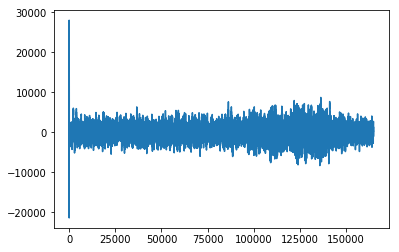

In [9]:
fig, ax = plt.subplots()
ax.plot(np.fromstring(audio.get_wav_data(), np.int16))

In [10]:
ipd.Audio("test_audio_recognition_saulo.wav")

In [11]:
translator = Translator()
translator.translate(text, src='en', dest='zh-cn').text

'我们走吧'

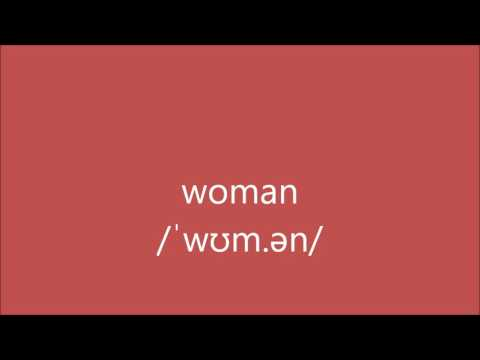

In [12]:
ipd.YouTubeVideo('z0E7YVsLRPM')

In [13]:
options = {
    'format': 'bestaudio/best',
    'outtmpl': '%(id)s.%(ext)s',
    'asr':'44100',
    'postprocessors': [{
        'key': 'FFmpegExtractAudio',
        'preferredcodec': 'wav',
        'preferredquality': '192',
    }],
}
youtube_dl.YoutubeDL(params=options).download(['https://www.youtube.com/watch?v=z0E7YVsLRPM'])

[youtube] z0E7YVsLRPM: Downloading webpage
[youtube] z0E7YVsLRPM: Downloading video info webpage
[download] Destination: z0E7YVsLRPM.m4a
[download] 100% of 1.64MiB in 00:05.80KiB/s ETA 00:00
[ffmpeg] Correcting container in "z0E7YVsLRPM.m4a"
[ffmpeg] Destination: z0E7YVsLRPM.wav
Deleting original file z0E7YVsLRPM.m4a (pass -k to keep)


0

In [14]:
ipd.Audio("z0E7YVsLRPM.wav")

In [ ]:
yt_audio = sr.AudioFile("z0E7YVsLRPM.wav")

r = sr.Recognizer()
with yt_audio as source:
    r.adjust_for_ambient_noise(source, duration=1)
    audio = r.listen(source)   
    try:
        text = r.recognize_google(audio)    # use recognizer to convert our audio into text part.
        print("The audio says : \n {}".format(text))
    except:
        print("Sorry could not recognize your audio")   

In [ ]:
translator = Translator()
translator.translate(text, src='en', dest='zh-cn').text

In [ ]:
'''
Trying to identify the sentences and add ponctuation automatically, but it is NOT working. =P
'''
tokenizer_words = nltk.tokenize.TweetTokenizer()
tokens_sentences = [tokenizer_words.tokenize(t) for t in nltk.sent_tokenize(text)]
print(tokens_sentences)

In [ ]:
'''
What is state-of-the-art on this technology?
'''
ipd.YouTubeVideo('bDxFvr1gpSU')

# List of references

#### https://realpython.com/python-speech-recognition/
#### https://github.com/ytdl-org/youtube-dl
#### https://willdrevo.com/downloading-youtube-and-soundcloud-audio-with-python-and-pandas
#### https://stackoverflow.com/questions/47685506/pygame-playing-mp3-files-downloaded-by-youtube-dl-is-not-working
#### https://en.wikipedia.org/wiki/Speech_recognition